# Geovisualization with PySAL



## Introduction

When the [Python Spatial Analysis Library](https://github.com/pysal), `PySAL`, was originally planned, the intention was to focus on the computational aspects of exploratory spatial data analysis and spatial econometric methods, while relying on existing GIS packages and visualization libraries for visualization of computations. Indeed, we have partnered with [esri](https://geodacenter.asu.edu/arc_pysal) and [QGIS](http://planet.qgis.org/planet/tag/pysal/ ) towards this end.

However, over time we have received many requests for supporting basic geovisualization within PySAL so that the step of having to interoperate with an exertnal package can be avoided, thereby increasing the efficiency of the spatial analytical workflow.



In this notebook, we demonstrate several approaches towards a particular subset of geovisualization methods, namely **choropleth maps**. We start with a exploratory workflow introducing mapclassify and geopandas to create different choropleth classifications and maps for quick exploratory data analysis. We then introduce the **geoviews** package for interactive mapping in support of exploratory spatial data analysis.




### PySAL Map Classifiers


In [1]:
import mapclassify
import geopandas as gpd
import matplotlib.pyplot as plt

In [2]:
shp_link = 'data/scag_region.gpkg'
gdf = gpd.read_file(shp_link)

/Users/knaaptime/anaconda3/envs/pysal-workshop/lib/python3.7/site-packages/mapclassify/classifiers.py:419: RuntimeWarning: invalid value encountered in greater
  binIds += (x > l) * (x <= r) * k
/Users/knaaptime/anaconda3/envs/pysal-workshop/lib/python3.7/site-packages/mapclassify/classifiers.py:419: RuntimeWarning: invalid value encountered in less_equal
  binIds += (x > l) * (x <= r) * k


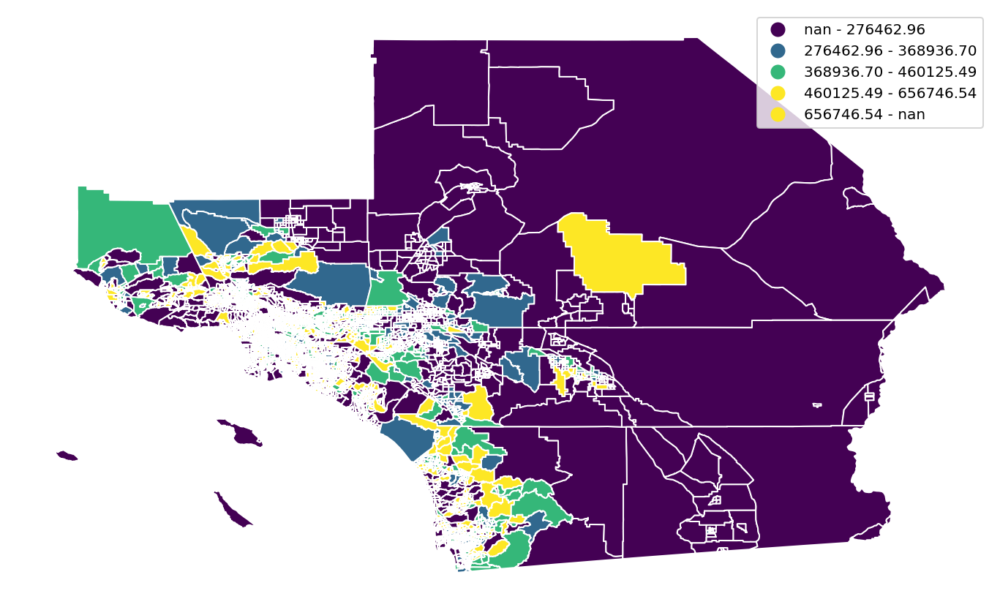

In [3]:
f, ax = plt.subplots(1, figsize=(12, 8))
gdf.plot(column='median_home_value', scheme='QUANTILES', ax=ax,
        edgecolor='white', legend=True)
ax.set_axis_off()
plt.show()

In [4]:
gdf.fillna(gdf.mean(), inplace = True) 
  

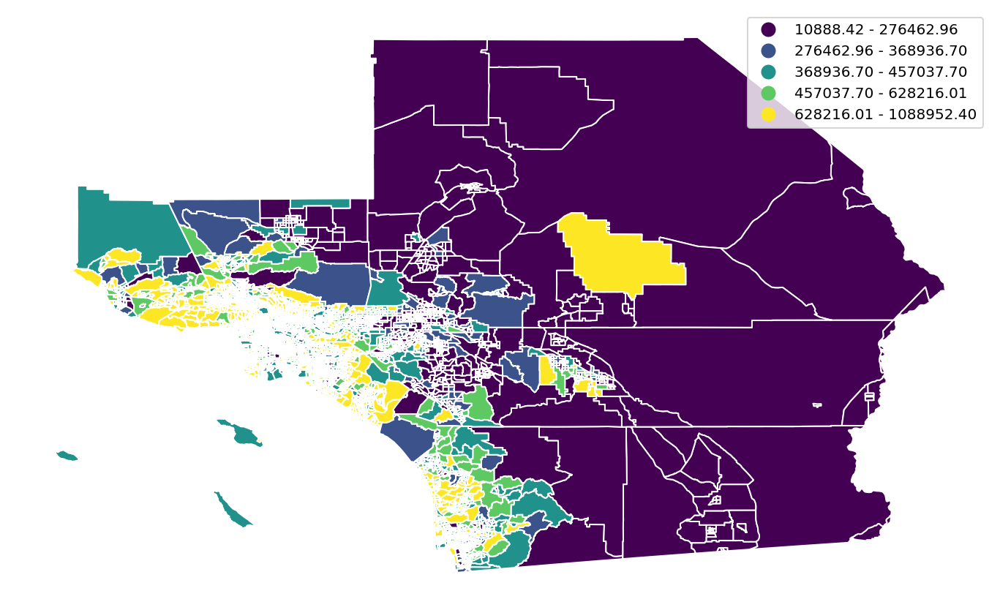

In [5]:
f, ax = plt.subplots(1, figsize=(12, 8))
gdf.plot(column='median_home_value', scheme='QUANTILES', ax=ax,
        edgecolor='white', legend=True)
ax.set_axis_off()
plt.show()

In [6]:
hv = gdf['median_home_value']

In [7]:
mapclassify.Quantiles(hv, k=5)

Quantiles                       

        Interval           Count
--------------------------------
[  10888.42,  276462.96] |   916
( 276462.96,  368936.70] |   917
( 368936.70,  457037.70] |   993
( 457037.70,  628216.01] |   840
( 628216.01, 1088952.40] |   914

In [8]:
mapclassify.Quantiles(hv, k=10)

Quantiles                       

        Interval           Count
--------------------------------
[  10888.42,  203688.34] |   458
( 203688.34,  276462.96] |   458
( 276462.96,  325454.88] |   458
( 325454.88,  368936.70] |   459
( 368936.70,  406233.29] |   457
( 406233.29,  457037.70] |   536
( 457037.70,  512928.74] |   380
( 512928.74,  628216.01] |   460
( 628216.01,  778142.83] |   456
( 778142.83, 1088952.40] |   458

In [9]:
q10 = mapclassify.Quantiles(hv, k=10)

In [10]:
dir(q10)

['__call__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_classify',
 '_fmt',
 '_set_bins',
 '_summary',
 '_table_string',
 '_update',
 'adcm',
 'bins',
 'classes',
 'counts',
 'find_bin',
 'fmt',
 'gadf',
 'get_adcm',
 'get_fmt',
 'get_gadf',
 'get_legend_classes',
 'get_tss',
 'k',
 'make',
 'name',
 'plot',
 'set_fmt',
 'table',
 'tss',
 'update',
 'y',
 'yb']

In [11]:
q10.bins

array([ 203688.34269663,  276462.9588015 ,  325454.87827715,
        368936.70411985,  406233.28651685,  457037.69973266,
        512928.73595506,  628216.01123596,  778142.82771536,
       1088952.39981273])

In [12]:
q10.counts

array([458, 458, 458, 459, 457, 536, 380, 460, 456, 458])

In [13]:
fj10 = mapclassify.FisherJenks(hv, k=10)

In [14]:
fj10

FisherJenks                     

        Interval           Count
--------------------------------
[  10888.42,  191982.12] |   428
( 191982.12,  278662.64] |   510
( 278662.64,  348355.52] |   663
( 348355.52,  417721.72] |   800
( 417721.72,  492314.89] |   679
( 492314.89,  580955.52] |   394
( 580955.52,  680594.57] |   392
( 680594.57,  804626.12] |   297
( 804626.12,  975482.58] |   184
( 975482.58, 1088952.40] |   233

In [15]:
fj10.adcm

98231639.16239837

In [16]:
q10.adcm

127632537.27184954

In [17]:
bins = [100000, 500000, 1000000, 1500000]

In [18]:
ud4 = mapclassify.UserDefined(hv, bins=bins)
ud4

UserDefined                     

        Interval           Count
--------------------------------
[  10888.42,  100000.00] |    61
( 100000.00,  500000.00] |  3054
( 500000.00, 1000000.00] |  1251
(1000000.00, 1500000.00] |   214

## GeoPandas: Choropleths

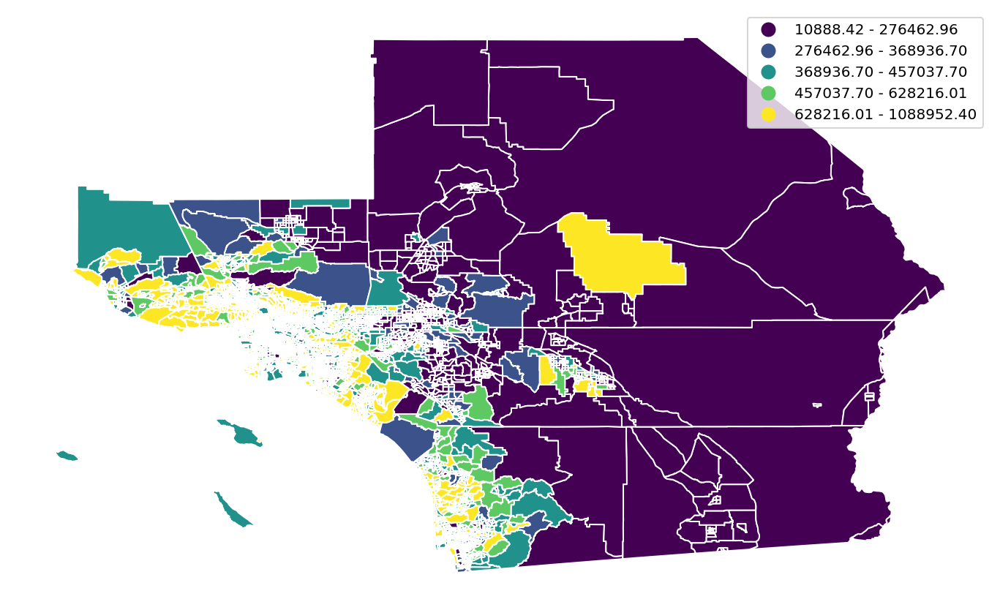

In [19]:
f, ax = plt.subplots(1, figsize=(12, 8))
gdf.plot(column='median_home_value', scheme='QUANTILES', ax=ax,
        edgecolor='white', legend=True)
ax.set_axis_off()
plt.show()

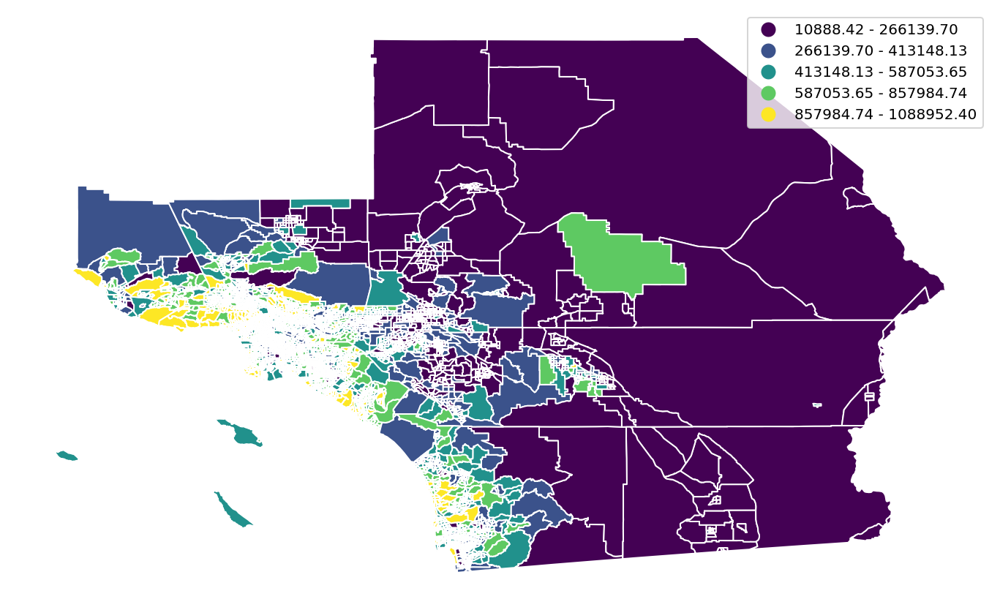

In [20]:
f, ax = plt.subplots(1, figsize=(12, 8))
gdf.plot(column='median_home_value', scheme='FisherJenks', ax=ax,
        edgecolor='white', legend=True)
ax.set_axis_off()
plt.show()

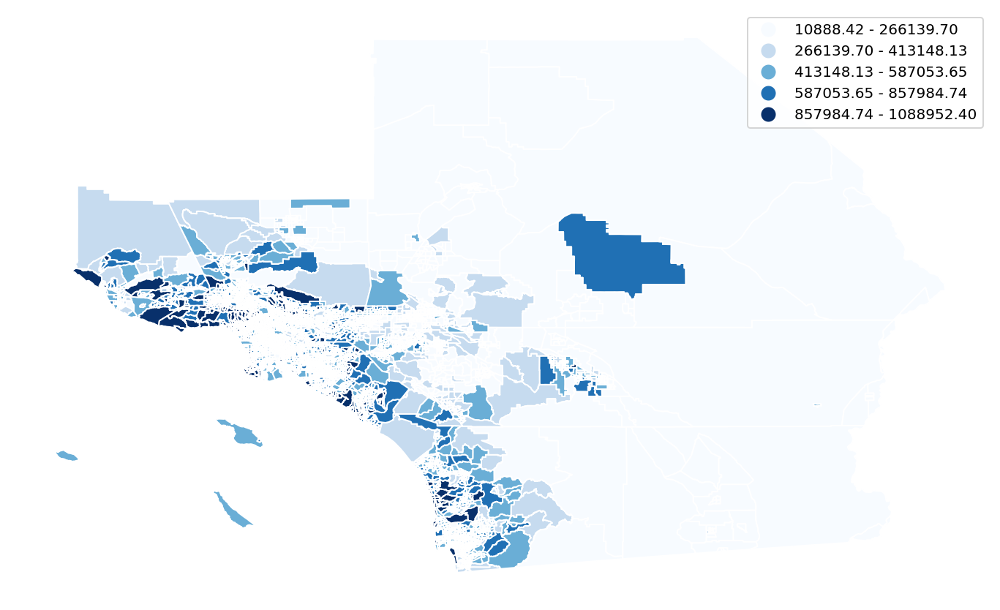

In [21]:
f, ax = plt.subplots(1, figsize=(12, 8))
gdf.plot(column='median_home_value', scheme='FisherJenks', ax=ax,
        edgecolor='white', legend=True, cmap='Blues')
ax.set_axis_off()
plt.show()

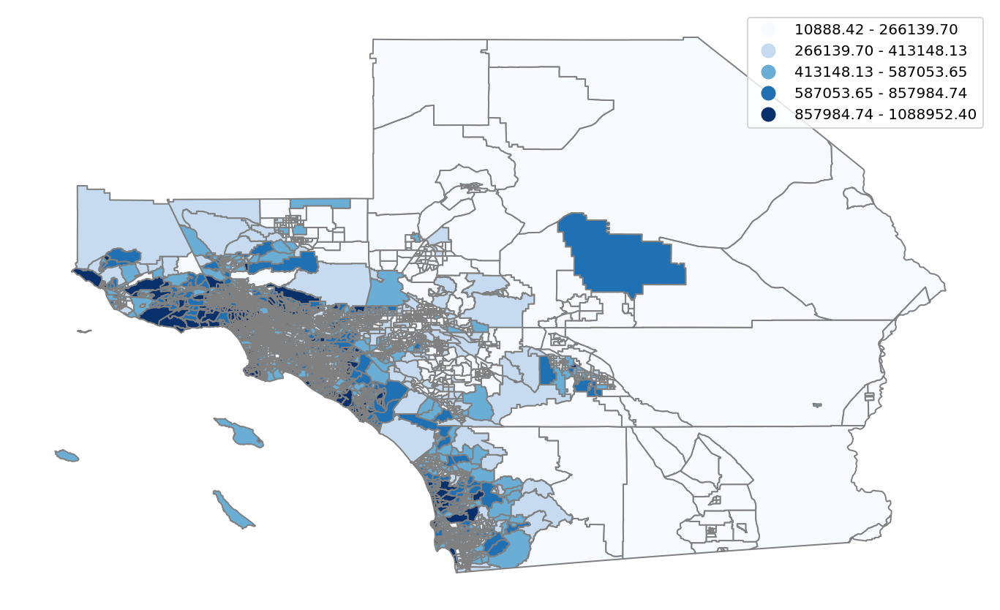

In [22]:
f, ax = plt.subplots(1, figsize=(12, 8))
gdf.plot(column='median_home_value', scheme='FisherJenks', ax=ax,
        edgecolor='grey', legend=True, cmap='Blues')
ax.set_axis_off()
plt.show()

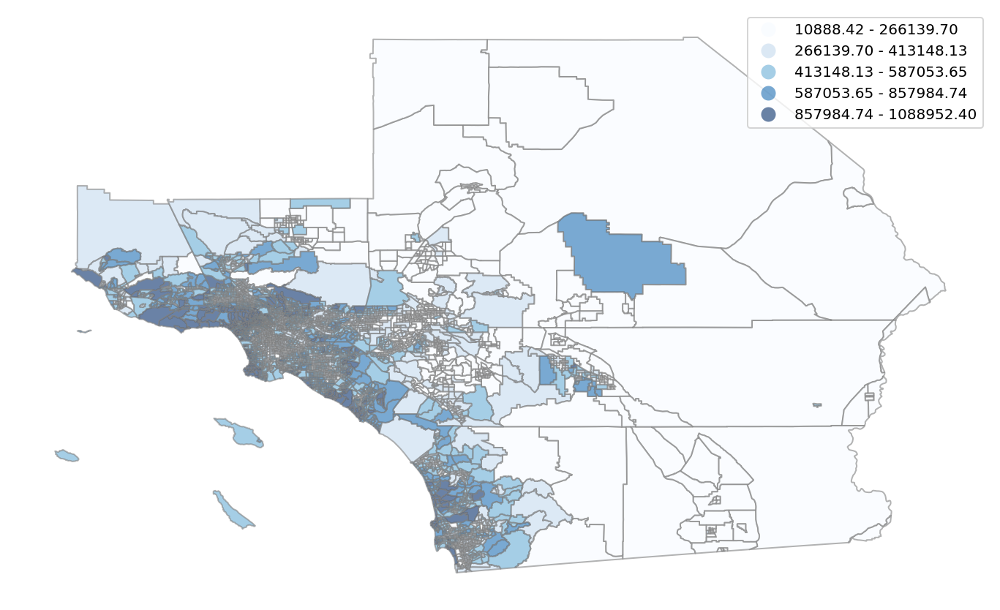

In [23]:
f, ax = plt.subplots(1, figsize=(12, 8))
gdf.plot(column='median_home_value', scheme='FisherJenks', ax=ax,
        edgecolor='grey', legend=True, cmap='Blues', alpha=0.6)
ax.set_axis_off()
plt.show()

In [24]:
gdf.geoid

0       06037128702
1       06037131600
2       06037134104
3       06037134304
4       06037242000
           ...     
4575    06037920029
4576    06037542000
4577    06111004304
4578    06065044804
4579    06037124400
Name: geoid, Length: 4580, dtype: object

In [25]:
import numpy

In [26]:
counties = set([geoid[:5] for geoid in gdf.geoid])

In [27]:
counties

{'06025', '06037', '06059', '06065', '06071', '06073', '06111'}

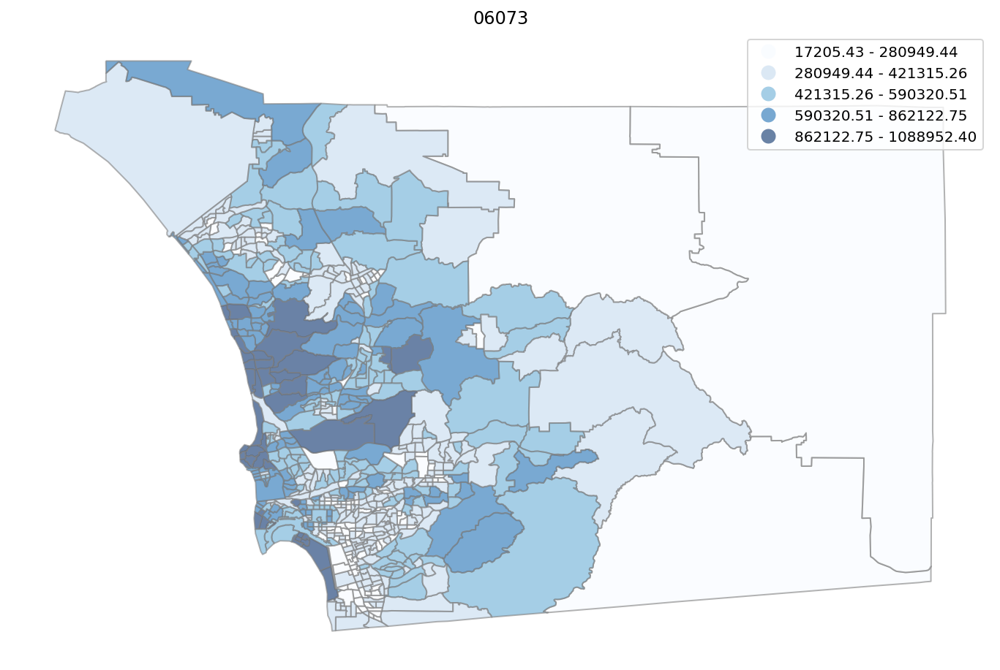

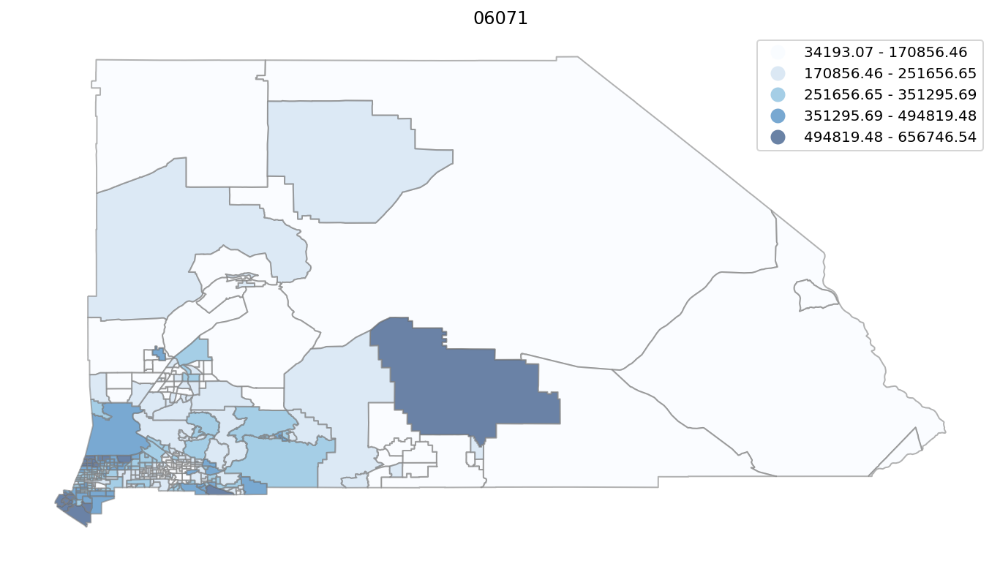

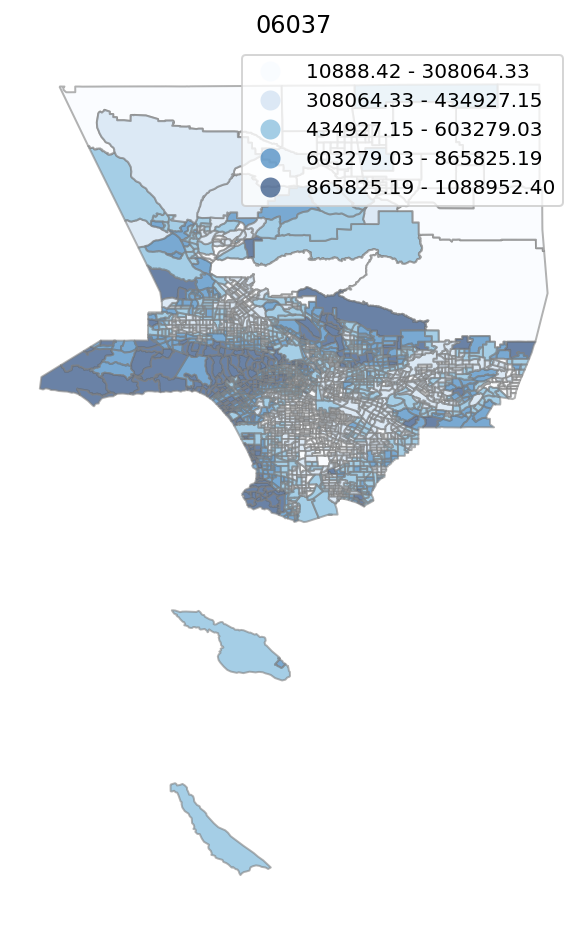

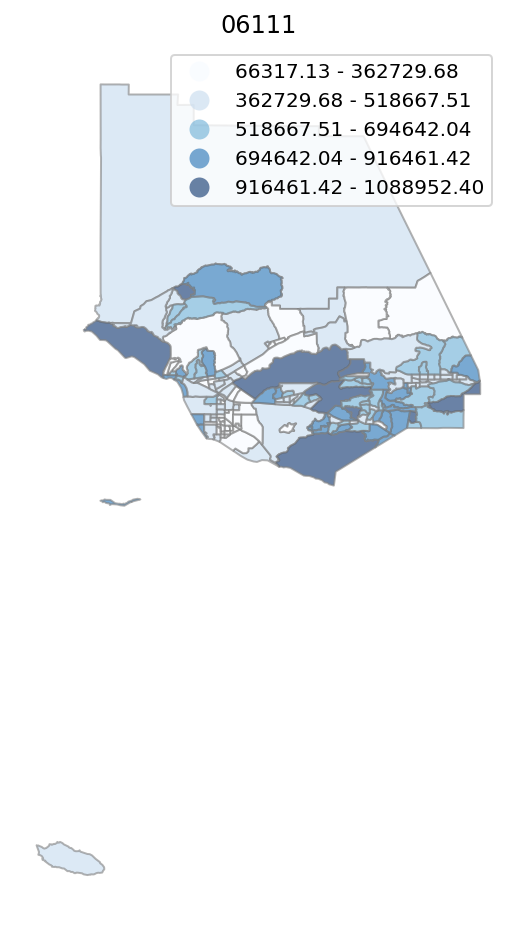

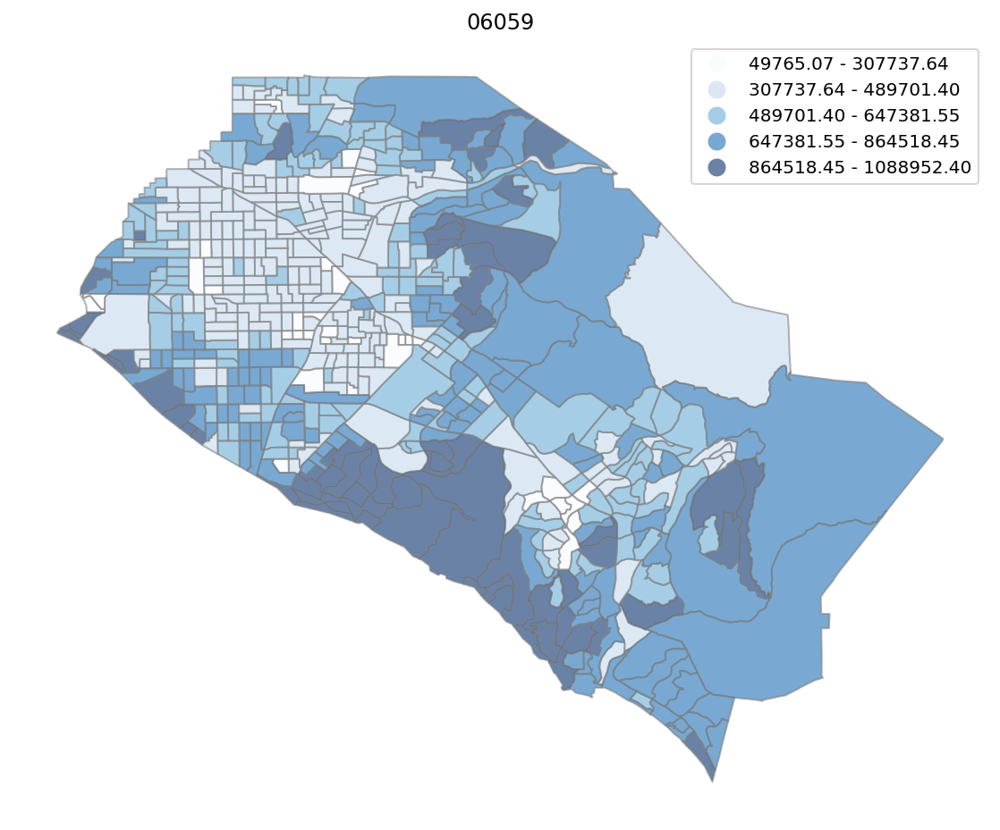

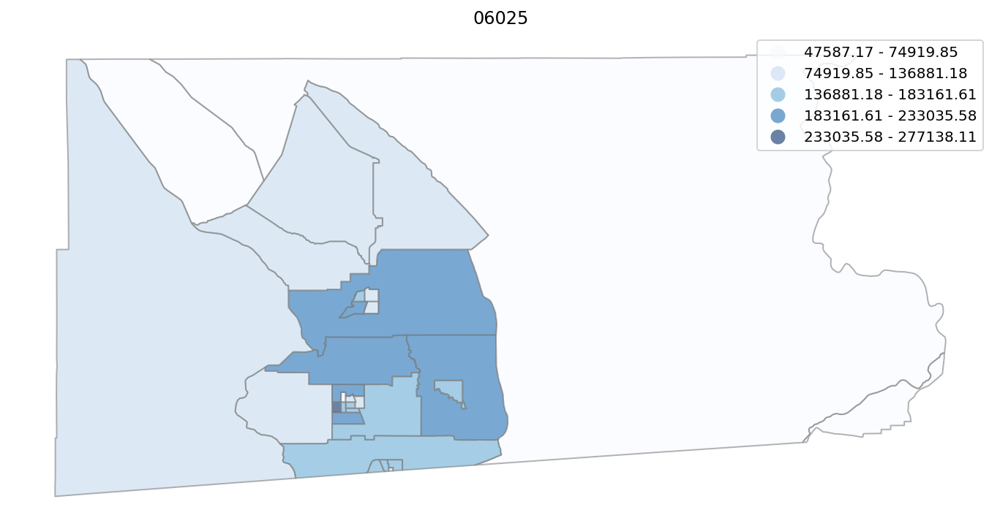

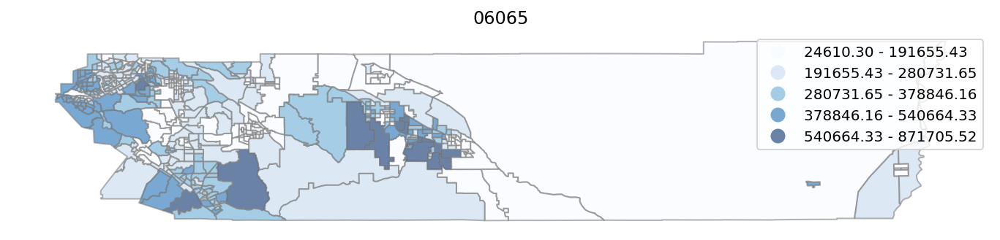

In [28]:
for county in counties:
    cgdf = gdf[gdf['geoid'].str.match(f'^{county}')]
    f, ax = plt.subplots(1, figsize=(12, 8))
    cgdf.plot(column='median_home_value', scheme='FisherJenks', ax=ax,
        edgecolor='grey', legend=True, cmap='Blues', alpha=0.6)
    plt.title(county)
    ax.set_axis_off()
    plt.show()


## Geoviews

In [29]:
import geoviews as gv
import geoviews.feature as gf
import xarray as xr
from cartopy import crs
import hvplot.pandas

In [30]:
import geopandas as gpd
cities = gpd.read_file(gpd.datasets.get_path('naturalearth_cities'))

cities.hvplot(global_extent=True, frame_height=450, tiles=True)

:Overlay
   .Tiles.I  :Tiles   [x,y]
   .Points.I :Points   [Longitude,Latitude]

In [31]:
shp_link = 'data/scag_region.gpkg'
gdf = gpd.read_file(shp_link)
gdf.fillna(gdf.mean(), inplace = True)

In [32]:
gdf.hvplot()

:Polygons   [x,y]

In [33]:
gdf.hvplot(geo=True)

:Polygons   [Longitude,Latitude]

In [34]:
def choro(df, field, scheme='Quantiles', ncolors=5, cmap='Blues',
          width=600, height=400, tools=['hover']):
    from holoviews.plotting.util import process_cmap
    cl = getattr(mapclassify, scheme)
    yb = cl(df[field], k=ncolors).yb
    pcmap = process_cmap(cmap, ncolors=ncolors)
    #yb, pcmap = choro(values, scheme=scheme, ncolors=ncolors, cmap=cmap)
    df[scheme] = yb
    return gv.Polygons(df, vdims=[scheme, field]).opts(cmap=pcmap, width=width, height=height, tools=tools, line_width=0.1)

    

In [35]:
choro(gdf, 'median_home_value')

:Polygons   [Longitude,Latitude]   (Quantiles,median_home_value)

In [36]:
choro(gdf, 'median_home_value', ncolors=9, cmap='Greens')

:Polygons   [Longitude,Latitude]   (Quantiles,median_home_value)

In [37]:
choro(gdf, 'median_home_value', scheme='FisherJenks', ncolors=9, cmap='Greens')

:Polygons   [Longitude,Latitude]   (FisherJenks,median_home_value)

<div class="alert alert-success" style="font-size:120%">
<b>Exercise</b>: <br>
Create choropleth maps for each of the counties that use the FisherJenks classification defined on the entire Southern California region.
</div>

In [38]:
# %load 

---

<a rel="license" href="http://creativecommons.org/licenses/by-nc-
sa/4.0/"><img alt="Creative Commons License" style="border-width:0"
src="https://i.creativecommons.org/l/by-nc-sa/4.0/88x31.png" /></a><br /><span
xmlns:dct="http://purl.org/dc/terms/" property="dct:title">Geovisualization</span> by <a xmlns:cc="http://creativecommons.org/ns#"
href="http://sergerey.org" property="cc:attributionName"
rel="cc:attributionURL">Serge Rey</a> is licensed under a <a
rel="license" href="http://creativecommons.org/licenses/by-nc-sa/4.0/">Creative
Commons Attribution-NonCommercial-ShareAlike 4.0 International License</a>.